In [1]:
import os
import folium
import shapely
import shapely.wkt
import numpy as np
import xarray as xr
#import hvplot.xarray
import rasterio as rio
import geopandas as gpd
import rasterio.plot as plot
import matplotlib.pyplot as plt

In [2]:
fig_dir = '/Users/coreyscher/Documents/GitHub/arset/arset/figures'
data_dir = '/Users/coreyscher/Documents/GitHub/arset/arset/data'

In [3]:
insar_path = '/Users/coreyscher/Documents/GitHub/arset/arset/data/insar'

pre_event_coh = os.path.join(insar_path, 
                         'S1AA_20160610T033416_20160821T033420_VVP072_INT40_G_ueF_3D10',
                         'S1AA_20160610T033416_20160821T033420_VVP072_INT40_G_ueF_3D10_corr.tif')

event_coh = os.path.join(insar_path, 
                         'S1AB_20160821T033420_20161026T033341_VVP066_INT40_G_ueF_C851',
                         'S1AB_20160821T033420_20161026T033341_VVP066_INT40_G_ueF_C851_corr.tif')

nyc_1_path = os.path.join(data_dir, 'nyc', 'S1A_IW_20220510T225122_DVR_RTC30_G_gpufed_FC84',
                          'S1A_IW_20220510T225122_DVR_RTC30_G_gpufed_FC84_VV.tif')
nyc_2_path = os.path.join(data_dir, 'nyc', 'S1A_IW_20220522T225123_DVR_RTC30_G_gpufed_1E09',
                          'S1A_IW_20220522T225123_DVR_RTC30_G_gpufed_1E09_VV.tif')

nyc_coh_path = os.path.join(data_dir, 'nyc', 'S1AA_20220510T225121_20220522T225122_VVR012_INT40_G_ueF_1AD4',
                          'S1AA_20220510T225121_20220522T225122_VVR012_INT40_G_ueF_1AD4_corr.tif')

nyc_tc_path = os.path.join(data_dir, 'nyc', '20220412T153809_20220412T153941_T18TWL.tif')

In [14]:
nyc_geoj.get_bounds()

[[40.6888, -74.0433], [40.8748, -73.8551]]

In [17]:
nyc_1.crs

CRS.from_epsg(32618)

/var/folders/xh/_p8fkhvx6wj7jc5dxd2_4rw40000gn/T/ipykernel_66280/999163042.py:17: RuntimeWarning: divide by zero encountered in log
  nyc_1_db = np.log(nyc_1.read()) * 10


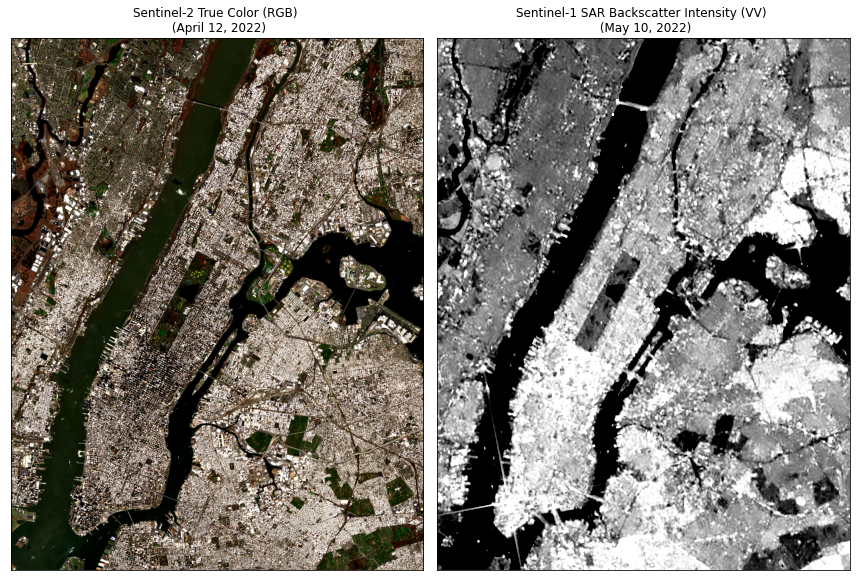

In [28]:
nyc_1 = rio.open(nyc_1_path)
nyc_tc = rio.open(nyc_tc_path)

#Define and area of interest as WKT over Aleppo, Syria
aoi = shapely.wkt.loads("POLYGON((37.0072 36.091, \
                        37.3326 36.091,37.3326 36.3183, \
                        37.0072 36.3183,37.0072 36.091))")
gs = gpd.GeoSeries(aoi, crs = 'EPSG:4326').to_crs(nyc_1.crs)
# Translate to geojson for quick addition to interactrive Folium maps
geo_j = folium.GeoJson(data=gs.to_json())

nyc_bounds = shapely.wkt.loads('POLYGON((-74.0433 40.6888,-73.8551 40.6888,-73.8551 40.8748,-74.0433 40.8748,-74.0433 40.6888))')
nyc_aoi = gpd.GeoSeries(nyc_bounds, crs = 'EPSG:4326').to_crs(nyc_1.crs)
# Translate to geojson for quick addition to interactrive Folium maps
nyc_geoj = folium.GeoJson(data=nyc_aoi.to_json())

nyc_1_db = np.log(nyc_1.read()) * 10

fig, ax = plt.subplots(1, 2, figsize=(12,10))

#plot.show(nyc_1.read(), ax=ax, vmin = )
plot.show(nyc_1_db, cmap = 'Greys_r', ax=ax[1], transform = nyc_1.transform, vmin=-25, vmax=10)
plot.show(nyc_tc, ax=ax[0], transform = nyc_tc.transform)

bnds = nyc_geoj.get_bounds()
x_lim = [bnds[0][1], bnds[1][1]]
y_lim = [bnds[0][0], bnds[1][0]]

for a in ax:

    a.set_xlim(x_lim)
    a.set_ylim(y_lim)

    a.set_xticks([])
    a.set_yticks([])
    
ax[0].set_title('Sentinel-2 True Color (RGB) \n (April 12, 2022)')
ax[1].set_title('Sentinel-1 SAR Backscatter Intensity (VV) \n (May 10, 2022)')
plt.tight_layout()
plt.savefig(os.path.join(fig_dir, 'nyc_ex_tc.png'), dpi = 300)

/var/folders/xh/_p8fkhvx6wj7jc5dxd2_4rw40000gn/T/ipykernel_81871/2696196030.py:2: RuntimeWarning: divide by zero encountered in log
  nyc_1_db = np.log(nyc_1.read()) * 10
/var/folders/xh/_p8fkhvx6wj7jc5dxd2_4rw40000gn/T/ipykernel_81871/2696196030.py:5: RuntimeWarning: divide by zero encountered in log
  nyc_2_db = np.log(nyc_2.read()) * 10


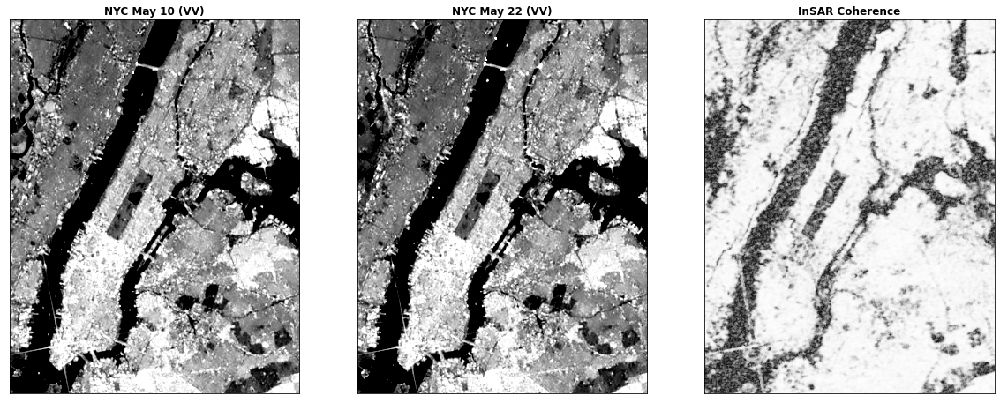

In [109]:
nyc_1 = rio.open(nyc_1_path)
nyc_1_db = np.log(nyc_1.read()) * 10

nyc_2 = rio.open(nyc_2_path)
nyc_2_db = np.log(nyc_2.read()) * 10

nyc_coh = rio.open(nyc_coh_path)

fig, ax = plt.subplots(1, 3, figsize=(20,8))

#plot.show(nyc_1.read(), ax=ax, vmin = )
plot.show(nyc_1_db, cmap = 'Greys_r', ax=ax[0], transform = nyc_1.transform, vmin=-25, vmax=10, title = 'NYC May 10 (VV)')
plot.show(nyc_2_db, cmap = 'Greys_r', ax=ax[1], transform = nyc_2.transform, vmin=-25, vmax=10, title = 'NYC May 22 (VV)')
plot.show(nyc_coh, cmap = 'Greys_r', ax=ax[2], transform = nyc_coh.transform, vmin=0, vmax=1, title = 'InSAR Coherence')

bnds = nyc_geoj.get_bounds()
x_lim = [bnds[0][1], bnds[1][1]]
y_lim = [bnds[0][0], bnds[1][0]]


for a in ax:
    a.set_xlim(x_lim)
    a.set_ylim(y_lim)

    a.set_xticks([])
    a.set_yticks([])

plt.savefig(os.path.join(fig_dir, 'nyc_ex2.png'), dpi = 300)

In [87]:
nyc_1.crs

CRS.from_epsg(32618)

In [4]:
pre = xr.open_dataset(pre_event_coh, engine="rasterio")
post = xr.open_dataset(event_coh, engine="rasterio")

In [88]:
#Define and area of interest as WKT over Aleppo, Syria
aoi = shapely.wkt.loads("POLYGON((37.0072 36.091, \
                        37.3326 36.091,37.3326 36.3183, \
                        37.0072 36.3183,37.0072 36.091))")
gs = gpd.GeoSeries(aoi, crs = 'EPSG:4326').to_crs(pre.rio.crs)
# Translate to geojson for quick addition to interactrive Folium maps
geo_j = folium.GeoJson(data=gs.to_json())

nyc_bounds = shapely.wkt.loads('POLYGON((-74.0433 40.6888,-73.8551 40.6888,-73.8551 40.8748,-74.0433 40.8748,-74.0433 40.6888))')
nyc_aoi = gpd.GeoSeries(nyc_bounds, crs = 'EPSG:4326').to_crs(nyc_1.crs)
# Translate to geojson for quick addition to interactrive Folium maps
nyc_geoj = folium.GeoJson(data=nyc_aoi.to_json())

In [6]:
#pre_proj = pre.rio.reproject("EPSG:4326")
#post_proj = post.rio.reproject("EPSG:4326")

pre_proj = pre.rio.clip(gs)
post_proj = post.rio.clip(gs)


[[3995328.6514057815, 320589.0765025929],
 [4021096.5155542158, 350321.05602725584]]

In [100]:
aligned = xr.align(pre_proj, post_proj)

In [105]:
post_proj.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    spatial_ref  int64 0
Data variables:
    band_data    float32 0.8454

In [106]:
pre_proj.mean()

<xarray.Dataset>
Dimensions:      ()
Coordinates:
    spatial_ref  int64 0
Data variables:
    band_data    float32 0.7902

In [107]:
# Calculate the change in coherence relative to the pre-conflict 

dif = (post_proj['band_data'] - pre_proj['band_data'])/pre_proj['band_data']

In [8]:
mask = pre_proj['band_data'] < 0.9

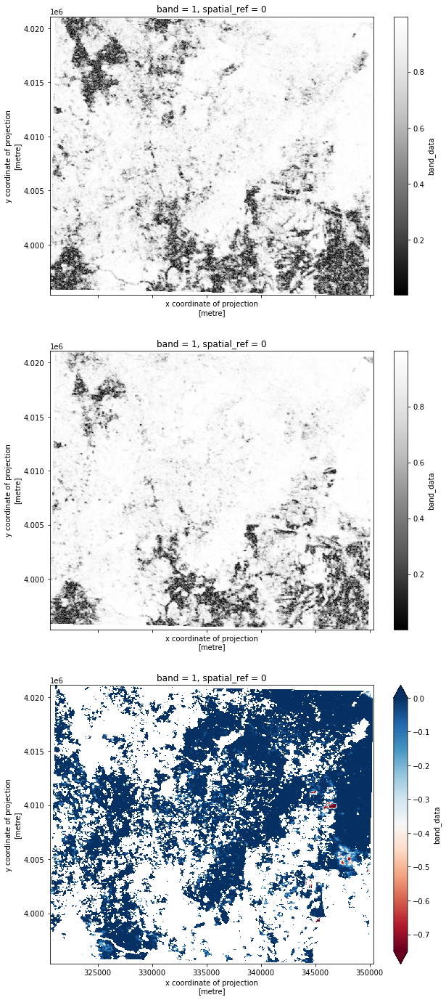

In [119]:
fig, ax = plt.subplots(3,1, figsize=(10,24), sharex=True)

mask = pre_proj['band_data'] < 0.8

pre_proj['band_data'].plot(cmap='Greys_r', ax = ax[0])
post_proj['band_data'].plot(cmap='Greys_r', ax = ax[1])

dif.where(pre_proj > 0.9)['band_data'].plot(cmap='RdBu', ax = ax[2], vmin = -.75, vmax = 0)

#dif.plot(cmap='RdBu', ax = ax[2], vmin = -.75, vmax = 0)
#dif_mask.where(dif_mask ==0).plot(cmap='RdBu', ax = ax[2], vmin = -.75, vmax = 0)

# for a in ax:
#     a.set_xlim(37.08, 37.22)
#     a.set_ylim(36.13, 36.26)
    
#plt.savefig(os.path.join(fig_dir, 'example_aleppo.png'), dpi=300, facecolor='white')

In [135]:
dif_plot = dif.where(pre_proj > 0.9)['band_data'].hvplot.quadmesh(cmap='RdBu',
                                                                  frame_width = 500,
                                                                 frame_height = 500)

hvplot.save(dif_plot, os.path.join(fig_dir, 'test_interactive_plot.html'))


## Print the plot!

dif_plot

:DynamicMap   [band]
   :QuadMesh   [x,y]   (band_data)